In [33]:
from src.porousflow.media_generator.utils.binary_blobs import periodic_binary_blobs
from src.porousflow.media_generator.utils.precolation_check import detect_percolation, fill_non_percolating_fluid, fill_non_percolating_fluid_periodic
from src.porousflow.lbm.lbm import LBM_solver
from src.porousflow.dispersion import run_dispersion_sim_physical_test
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [34]:
i=0
while True:
    media = periodic_binary_blobs(n_dim=2, length=128,volume_fraction=0.5,blob_size_fraction=0.1, seed=i)
    x_perc, y_perc, _ = detect_percolation(media)
    if x_perc and y_perc:
        # filled_media = fill_non_percolating_fluid_periodic(media)
        break
    i+=1

print(i)


2


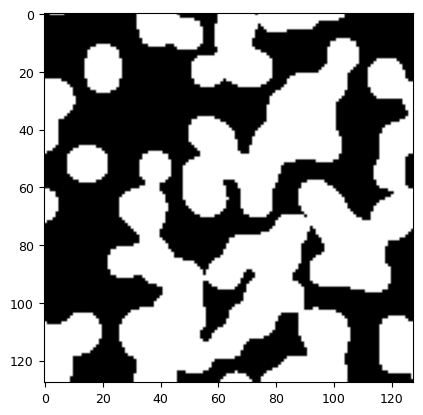

In [35]:
plt.imshow(media, cmap='gray')

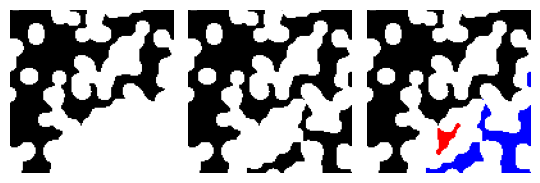

In [38]:
filled = fill_non_percolating_fluid(media)
filled_periodic = fill_non_percolating_fluid_periodic(media)
diff_filled = filled != media
diff_periodic = filled_periodic != filled

# Create an RGB image for visualization
# Initialize with the original media in grayscale
rgb_img = np.stack([media, media, media], axis=-1).astype(float)  # shape (H, W, 3)

# Highlight filled differences in blue
rgb_img[diff_filled] = [1, 0, 0]  # blue

# Highlight differences between filled and filled_periodic in red
rgb_img[diff_periodic] = [0, 0, 1]  # red


plt.rcParams.update({
    'font.size': 10,            # default font size
    'axes.titlesize': 10,       # subplot titles
    'axes.labelsize': 10,       # axis labels
    'xtick.labelsize': 9,       # x tick labels
    'ytick.labelsize': 9,       # y tick labels
    'legend.fontsize': 9,       # legend text
    'figure.titlesize': 14,     # figure-level title
})
fig, ax = plt.subplots(1, 3, figsize=(5.5, 3))
ax[0].imshow(filled, cmap='gray')
# ax[0].set_title('Filled')
ax[1].imshow(filled_periodic, cmap='gray')
# ax[1].set_title('Periodically Filled')
ax[2].imshow(rgb_img, cmap='gray')
# ax[2].set_title('Colored Difference')
ax[0].axis('off')
ax[1].axis('off')
ax[2].axis('off')
plt.tight_layout()
plt.savefig('demo_plots/periodic_filling_demo.pdf',bbox_inches='tight')
plt.show()

In [6]:
results_x = LBM_solver(filled_periodic,force_dir=0,tau=0.6,force_strength=1e-1)
results_y = LBM_solver(filled_periodic,force_dir=1,tau=0.6,force_strength=1e-1)


In [7]:
print(
    f"Simulation in x direction finished in: {results_x[3]} iterations\n"
    f"Simulation in y direction finished in: {results_y[3]} iterations\n"
)

Simulation in x direction finished in: 7600 iterations
Simulation in y direction finished in: 8500 iterations



Re: x:4.804e-02, y:6.804e-02
Ma: x:2.167e-05, y:3.069e-05
K=
 1.876106124414458e-10, -5.0353930307781556e-11
 -5.036512728943375e-11, 2.44762158328972e-10

Relative symmetry error: 0.022%


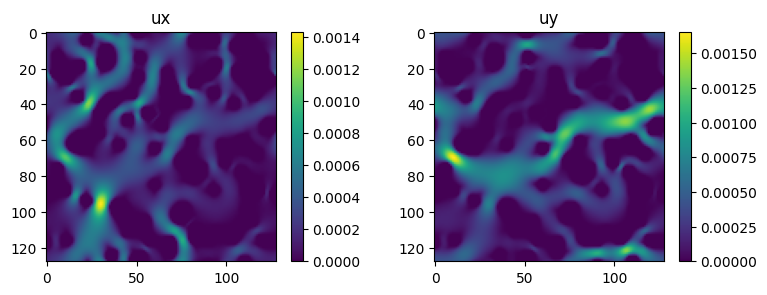

In [8]:
print(f"Re: x:{results_x[5]:.3e}, y:{results_y[5]:.3e}")
print(f"Ma: x:{results_x[4]:.3e}, y:{results_y[4]:.3e}")
print(
    "K=\n"
    f" {results_x[1]}, {results_x[2]}\n"
    f" {results_y[1]}, {results_y[2]}\n"
    )

print(f"Relative symmetry error: {abs((results_y[1]-results_x[2])/results_y[1]) *100:.3f}%")

ux = results_x[0]
uy = results_y[0]
ux_mag = np.sqrt(ux[:,:,0]**2 + ux[:,:,1]**2)
uy_mag = np.sqrt(uy[:,:,0]**2 + uy[:,:,1]**2)
fig, ax = plt.subplots(1, 2, figsize=(8,3))
x = ax[0].imshow(ux_mag, cmap='viridis')
ax[0].set_title('ux')
ax[1].set_title('uy')
fig.colorbar(x, ax=ax[0])
y = ax[1].imshow(uy_mag, cmap='viridis')
fig.colorbar(y, ax=ax[1])
plt.tight_layout()
plt.show()

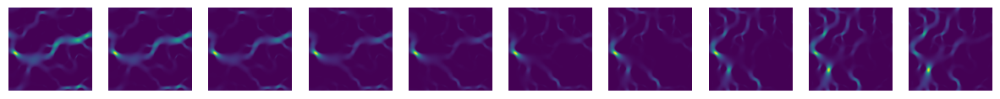

In [9]:

alpha = np.linspace(0,1,10)
fig,ax = plt.subplots(1,10,figsize=(15,3))
for a,al in zip(ax,alpha):
    u = al*ux + (1-al)*uy
    a.imshow(u[:,:,0]**2 + u[:,:,1]**2)
    a.axis('off')
plt.show()

In [11]:
target_Pe = 50
L = 128#0.25 * 128 * (0.1)
D_m = L/target_Pe
print(f"L={L}")
print(f"D_m={D_m}")
print(f't~{L**2/D_m}')
steps = int(100 * L**2/D_m)



ux_mean = np.mean(ux)
ux = ux/ux_mean

uy_mean = np.mean(uy)
uy = uy/uy_mean

dt_x = ((-1+np.sqrt(1+np.max(ux)))**2)/(2*np.max(ux)**2)
dt_y = ((-1+np.sqrt(1+np.max(uy)))**2)/(2*np.max(uy)**2)

print(dt_x)
print(dt_y)
# dt = 1e-3
# print(steps)

L=128
D_m=2.56
t~6400.0
0.01190928179457833
0.01614483361435872


In [12]:
Dx, Mx, px = run_dispersion_sim_physical_test(solid=media, velocity=ux,steps=steps, num_particles=500, D=D_m, dt=dt_x)
Dy, My, py = run_dispersion_sim_physical_test(solid=media, velocity=uy,steps=steps, num_particles=500, D=D_m, dt=dt_y)

In [13]:
print(
    f"Dx: Dx_xx: {Dx[0,0]:.3e}, Dx_xy: {Dx[0,1]:.3e}, Dx_yx: {Dx[1,0]:.3e}, Dx_yy: {Dx[1,1]:.3e}\n"
    f"Dy: Dy_xx: {Dy[0,0]:.3e}, Dy_xy: {Dy[0,1]:.3e}, Dy_yx: {Dy[1,0]:.3e}, Dy_yy: {Dy[1,1]:.3e}\n"
)

Dx: Dx_xx: 5.086e+01, Dx_xy: -5.838e+00, Dx_yx: -5.838e+00, Dx_yy: 9.993e+00
Dy: Dy_xx: 1.166e+01, Dy_xy: -1.352e+01, Dy_yx: -1.352e+01, Dy_yy: 1.021e+02



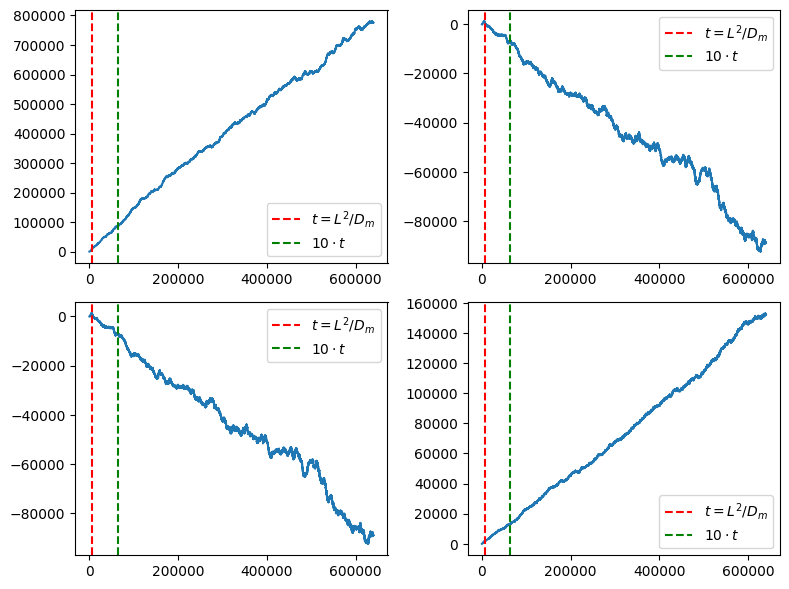

In [14]:
t = L**2 / D_m
tlong = 10 * t

fig, ax = plt.subplots(2, 2, figsize=(8, 6))
ax[0,0].plot(Mx[:,0,0])
ax[0,1].plot(Mx[:,0,1])
ax[1,0].plot(Mx[:,1,0])
ax[1,1].plot(Mx[:,1,1])

for a in ax.flatten():
    a.axvline(t, color='r', linestyle='--', label=r'$t=L^2/D_m$')
    a.axvline(tlong, color='g', linestyle='--', label=r'$10\cdot t$')
    a.legend()
    # a.set_xscale('log')
    # a.set_yscale('log')

plt.tight_layout()
plt.show()


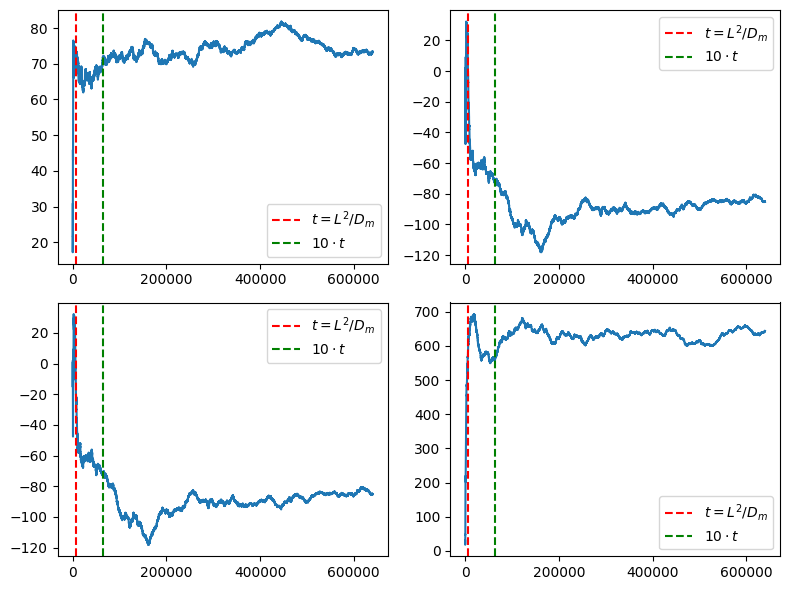

In [15]:
t = L**2 / D_m
tlong = 10 * t

fig, ax = plt.subplots(2, 2, figsize=(8, 6))
t_ = np.arange(My.shape[0])*dt
ax[0,0].plot(My[1:,0,0]/(2*t_[1:]*D_m))
ax[0,1].plot(My[1:,0,1]/(2*t_[1:]*D_m))
ax[1,0].plot(My[1:,1,0]/(2*t_[1:]*D_m))
ax[1,1].plot(My[1:,1,1]/(2*t_[1:]*D_m))

for a in ax.flatten():
    a.axvline(t, color='r', linestyle='--', label=r'$t=L^2/D_m$')
    a.axvline(tlong, color='g', linestyle='--', label=r'$10\cdot t$')
    a.legend()
    # a.set_xscale('log')
    # a.set_yscale('log')

plt.tight_layout()
plt.show()

Animation size has reached 21042462 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


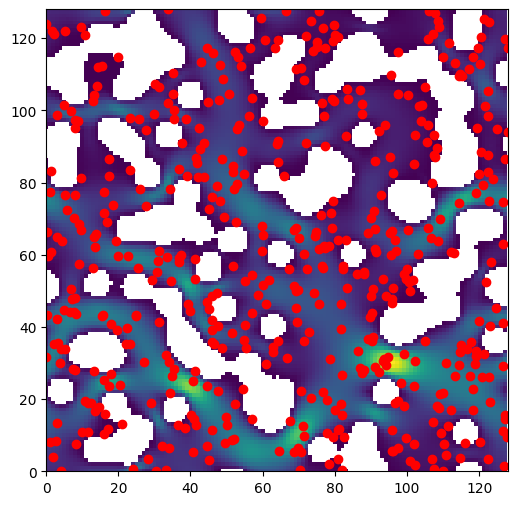

In [16]:
fig, ax = plt.subplots(figsize=(6, 6))

# Display the static background
# im = ax.imshow(filled_periodic.T, cmap='gray', origin='lower')
ux_mag= np.sqrt(ux[:,:,0]**2 + ux[:,:,1]**2)
masked = np.where(filled_periodic,np.nan,ux_mag)
u = ax.imshow(masked.T, cmap='viridis', origin='lower')

# Create scatter objects for particles
scat = ax.scatter(px[:,0,0], px[:,1,0], c='red')

ax.set_xlim(0, filled_periodic.shape[1])
ax.set_ylim(0, filled_periodic.shape[0])

def update(i):
    # Update particle positions
    scat.set_offsets(px[:, :2, i])
    return [u, scat]

ani = FuncAnimation(fig, update, frames=px.shape[2], interval=100, blit=True)
HTML(ani.to_jshtml())

In [17]:
# ani.save("particle_distribution_random.gif") 
# HTML(ani.to_jshtml())

In [18]:
# %matplotlib inline
# fig, axes = plt.subplots(1, 2, figsize=(8, 4))
# def update(i):
#         axes[0].cla()
#         axes[1].cla()

#         pa_x = axes[0].hist(px[:, 0, i], bins=50)
#         axes[0].set_title(f"X distribution (step={i*1e3:.0f})")
#         # axes[0].set_xlim(-10,140)
#         axes[0].set_ylim(0,100)

#         pa_y = axes[1].hist(px[:, 1, i], bins=50)
#         axes[1].set_title(f"Y distribution (step={i*1e3:.0f})")
#         # axes[1].set_xlim(-10,1000)
#         axes[1].set_ylim(0,100)
#         return pa_x[2] + pa_y[2]
# ani = FuncAnimation(fig, update, frames=px.shape[2], interval=100)
# HTML(ani.to_jshtml())

In [19]:
# fig, axes = plt.subplots(1, 2, figsize=(8, 4))
# def update(i):
#         axes[0].cla()
#         axes[1].cla()

#         pa_x = axes[0].hist(py[:, 0, i], bins=50)
#         axes[0].set_title(f"X distribution (step={i*1e3:.0f})")
#         # axes[0].set_xlim(-10,140)
#         axes[0].set_ylim(0,100)

#         pa_y = axes[1].hist(py[:, 1, i], bins=50)
#         axes[1].set_title(f"Y distribution (step={i*1e3:.0f})")
#         # axes[1].set_xlim(-10,1000)
#         axes[1].set_ylim(0,100)
#         return pa_x[2] + pa_y[2]
# ani = FuncAnimation(fig, update, frames=py.shape[2], interval=100)
# HTML(ani.to_jshtml())

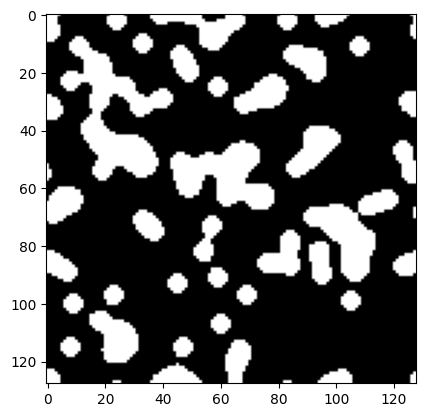

In [20]:
import numpy as np

image = np.load('data/media_samples_train/media_samples.npz')['filled_images'][5]
plt.imshow(image, cmap='gray')

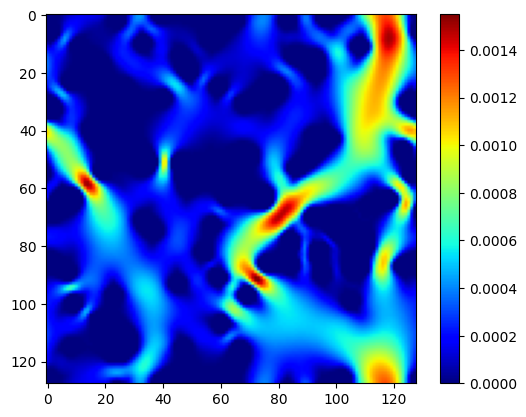

In [21]:
simulation_results = np.load('data/lbm_simulation_results_train/simulation_result_5.npz')
ux = simulation_results['ux_physical']
uy = simulation_results['uy_physical']
ux_mag = np.sqrt(ux[:,:,0]**2 + ux[:,:,1]**2)
plt.imshow(ux_mag, cmap='jet')
plt.colorbar()


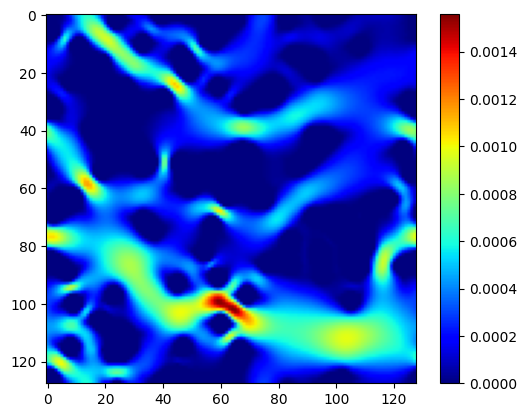

In [22]:
uy_mag = np.sqrt(uy[:,:,0]**2 + uy[:,:,1]**2)
plt.imshow(uy_mag, cmap='jet')
plt.colorbar()

In [23]:
import os
os.environ["NUMBA_THREADING_LAYER"] = "omp"   # force OpenMP
from numba import njit, prange

@njit(parallel=True)
def test():
    s = 0
    for i in prange(1000):
        s += i
    return s

test()  # triggers initialization


499500

In [24]:
import numba
print(numba.threading_layer())


omp
